In [20]:
# get pkl mp
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/computerome/currents/tt_sce_mp.pkl', 'rb')
tt_sce_mp = pickle.load(pkl_file)
pkl_file.close()

tt_sce_mp

{'ℓ_s_log__': array(0.70605487),
 'η_s_log__': array(-6.38616081),
 'ℓ_l_log__': array(0.72699393),
 'η_l_log__': array(-4.06943083),
 'σ_log__': array(-2.10655974),
 'ℓ_s': array(2.0259827),
 'η_s': array(0.00168471),
 'ℓ_l': array(2.06885214),
 'η_l': array(0.01708711),
 'σ': array(0.12165578)}

In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pymc3 as pm

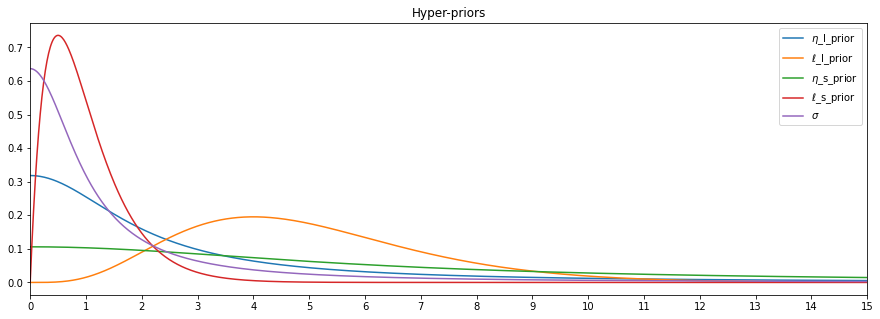

In [19]:
#def get_spatial_hps(plot = False):

    #"""Get the one trend spetial prior"""

η_l_beta = 2
ℓ_l_beta = 1
ℓ_l_alpha = 5

η_s_beta = 6
ℓ_s_beta = 2
ℓ_s_alpha = 2

σ_beta = 1

grid = np.linspace(0,15,1000)
priors = [
        ('$\eta$_l_prior', pm.HalfCauchy.dist(beta=η_l_beta)),
        ('$\ell$_l_prior', pm.Gamma.dist(alpha=ℓ_l_alpha , beta=ℓ_l_beta )),
        ('$\eta$_s_prior', pm.HalfCauchy.dist(beta=η_s_beta)),
        ('$\ell$_s_prior', pm.Gamma.dist(alpha=ℓ_s_alpha , beta=ℓ_s_beta )),
        ('$\sigma$', pm.HalfCauchy.dist(beta=σ_beta))]

    #if plot == True:

plt.figure(figsize= [15,5])
plt.title('Hyper-priors')

for i, prior in enumerate(priors):
    plt.plot(grid, np.exp(prior[1].logp(grid).eval()), label = prior[0])

plt.xticks(np.arange(0,16,1))
plt.xlim(0,15)
plt.legend()
plt.show()

    #return(η_beta, ℓ_beta, ℓ_alpha, σ_beta)

# sce pred (fine and working):

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import pickle


In [2]:
# get pkl mp
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/computerome/currents/sce_pred_df.pkl', 'rb')
sce_pred_df = pickle.load(pkl_file)
pkl_file.close()
sce_pred_df.sample(6)

,mu,var,month_id,xcoord,ycoord,log_best
1640701,5.383510e-02,0.000178,274,21.75,16.25,0.0
1086875,3.987861e-05,0.000295,222,-6.25,22.75,0.0
221763,-8.481383e-08,0.000294,141,18.25,21.25,0.0
2700655,5.220607e-05,0.000295,373,-6.75,30.75,0.0
2387510,1.758327e-03,0.000287,344,30.25,13.75,0.0
73462,2.389978e-07,0.000295,127,-10.25,27.25,0.0


In [3]:
sce_pred_df.shape

(2818728, 6)

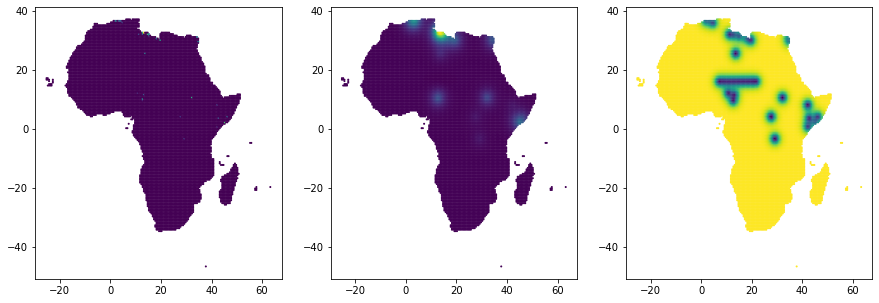

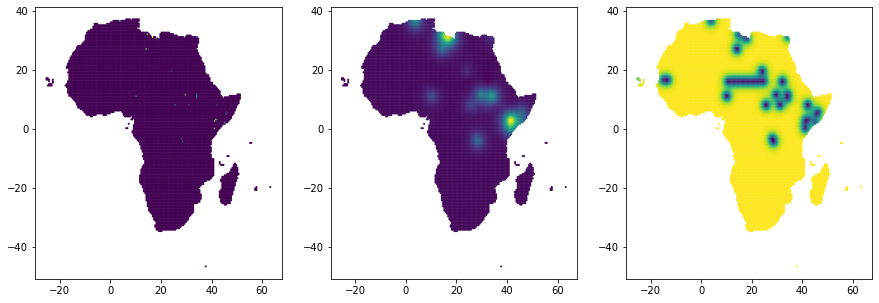

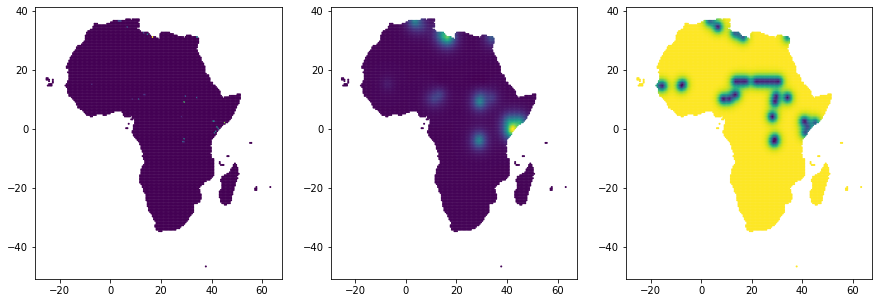

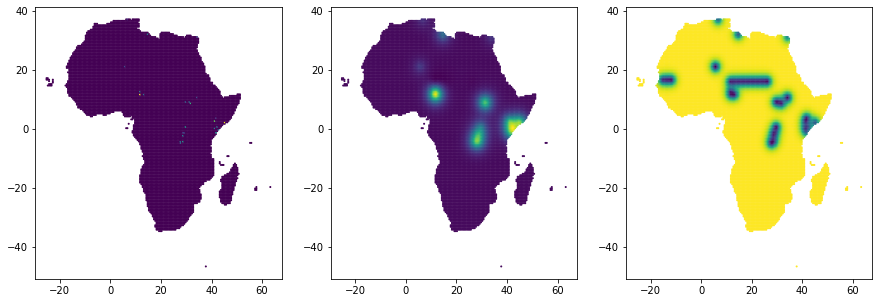

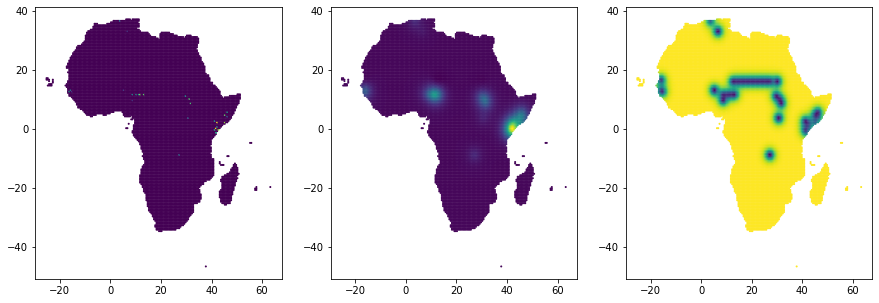

In [4]:
month_ids = sce_pred_df['month_id'].unique()[-5:]

for i, j in enumerate(month_ids):

    plt.figure(figsize=[15,5])
    plt.subplot(1,3,1)
    plt.scatter(sce_pred_df[sce_pred_df['month_id'] == j]['xcoord'], 
                            sce_pred_df[sce_pred_df['month_id'] == j]['ycoord'], 
                            c = sce_pred_df[sce_pred_df['month_id'] == j]['log_best'], s = 1)


    plt.subplot(1,3,2)
    plt.scatter(sce_pred_df[sce_pred_df['month_id'] == j]['xcoord'], 
                            sce_pred_df[sce_pred_df['month_id'] == j]['ycoord'], 
                            c = sce_pred_df[sce_pred_df['month_id'] == j]['mu'], s = 1)


    plt.subplot(1,3,3)
    plt.scatter(sce_pred_df[sce_pred_df['month_id'] == j]['xcoord'], 
                            sce_pred_df[sce_pred_df['month_id'] == j]['ycoord'], 
                            c = sce_pred_df[sce_pred_df['month_id'] == j]['var'], s = 1)


plt.show()